## Setup

### Libraries

In [1]:
import numpy as np
import pandas as pd
import os
import anndata as ad
import scanpy as sc
import squidpy as sq

import seaborn as sns
from matplotlib import pyplot as plt
from matplotlib import rcParams
import matplotlib.colors as clr
from matplotlib.pyplot import rc_context
import glasbey

import gc
import scvi
import torch
from lightning.pytorch import seed_everything

c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\dask\dataframe\__init__.py:31: FutureWarning: The legacy Dask DataFrame implementation is deprecated and will be removed in a future version. Set the configuration option `dataframe.query-planning` to `True` or None to enable the new Dask Dataframe implementation and silence this warning.
  warnings.warn(
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\anndata\utils.py:434: FutureWarning: Importing read_text from `anndata` is deprecated. Import anndata.io.read_text instead.
  warnings.warn(msg, FutureWarning)
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\docrep\decorators.py:43: SyntaxWarning: 'param_categorical_covariate_keys' is not a valid key!
  doc = f

In [2]:
torch.set_float32_matmul_precision('high')
torch.cuda.is_available()
seed_everything(12345)
sc.settings.n_jobs = 12

Seed set to 12345


# Load anndata objects

Add to the scanvi object with cellcharter so you have one object to rule them all

In [ ]:
adata = sc.read_h5ad("../../data/merfish/BAYSOR/seurat_objects/ns-atlas.merfish_baysor.scanvi_integrated.cellcharter.anndata.h5ad")

In [23]:
immune_metadata = pd.read_csv("../../data/merfish/BAYSOR/reclustering/Immune/Immune.reclustered.baysor.scvi_integrated.cell_metadata.csv", index_col=0)
epithelia_metadata = pd.read_csv("../../data/merfish/BAYSOR/reclustering/Epithelia/Epithelia.reclustered.baysor.scvi_integrated.cell_metadata.csv", index_col=0)
stroma_metadata = pd.read_csv("../../data/merfish/BAYSOR/reclustering/Stroma/Stroma.reclustered.baysor.scvi_integrated.cell_metadata.csv", index_col=0)

C:\Users\Paula\AppData\Local\Temp\ipykernel_15324\1891282461.py:1: DtypeWarning: Columns (0,22) have mixed types. Specify dtype option on import or set low_memory=False.
  immune_metadata = pd.read_csv("../../data/merfish/BAYSOR/reclustering/Immune/Immune.reclustered.baysor.scvi_integrated.cell_metadata.csv", index_col=0)
C:\Users\Paula\AppData\Local\Temp\ipykernel_15324\1891282461.py:2: DtypeWarning: Columns (0,22) have mixed types. Specify dtype option on import or set low_memory=False.
  epithelia_metadata = pd.read_csv("../../data/merfish/BAYSOR/reclustering/Epithelia/Epithelia.reclustered.baysor.scvi_integrated.cell_metadata.csv", index_col=0)
C:\Users\Paula\AppData\Local\Temp\ipykernel_15324\1891282461.py:3: DtypeWarning: Columns (0,22) have mixed types. Specify dtype option on import or set low_memory=False.
  stroma_metadata = pd.read_csv("../../data/merfish/BAYSOR/reclustering/Stroma/Stroma.reclustered.baysor.scvi_integrated.cell_metadata.csv", index_col=0)


In [7]:
immune_metadata = immune_metadata[['cell_barcode', 'cell_type.detailed']]
epithelia_metadata = epithelia_metadata[['cell_barcode', 'cell_type.detailed']]
stroma_metadata = stroma_metadata[['cell_barcode', 'cell_type.detailed']]

In [8]:
toadd = pd.concat([immune_metadata, epithelia_metadata, stroma_metadata])

In [9]:
toadd.index = toadd.index.values.tolist()
toadd.index = toadd.index.astype('str').values.tolist()

In [10]:
fib_metadata = pd.read_csv("../../data/merfish/BAYSOR/reclustering/Fibroblast/Fibroblast.reclustered.baysor.scvi_integrated.cell_metadata.csv", index_col=0)
fib_metadata = fib_metadata[['cell_barcode', 'cell_type.detailed']]
fib_metadata.index = fib_metadata.index.astype('str').values.tolist()

C:\Users\Paula\AppData\Local\Temp\ipykernel_15324\1687033745.py:1: DtypeWarning: Columns (0,22) have mixed types. Specify dtype option on import or set low_memory=False.
  fib_metadata = pd.read_csv("../../data/merfish/BAYSOR/reclustering/Fibroblast/Fibroblast.reclustered.baysor.scvi_integrated.cell_metadata.csv", index_col=0)


In [11]:
fib_barcodes = np.intersect1d(toadd.index.values.tolist(), fib_metadata.cell_barcode.values.tolist())

In [12]:
toadd['cell_type.detailed'] = toadd['cell_type.detailed'].astype('str').values.tolist()
fib_metadata['cell_type.detailed'] = fib_metadata['cell_type.detailed'].astype('str').values.tolist()

In [13]:
toadd.loc[fib_barcodes, 'cell_type.detailed'] = fib_metadata.loc[fib_barcodes, 'cell_type.detailed'].values.tolist()

collapse the plasma annots and make that immune EC annot a VEC

In [56]:
toadd.loc[toadd['cell_type.detailed'] == 'Plasma I', 'cell_type.detailed'] = 'Plasma'
toadd.loc[toadd['cell_type.detailed'] == 'Plasma II', 'cell_type.detailed'] = 'Plasma'
toadd.loc[toadd['cell_type.detailed'] == 'EC', 'cell_type.detailed'] = 'VEC'

In [57]:
toadd['cell_type.detailed'].unique()

array(['Ecc Gland', 'Doublet', 'Peri', 'Retic Fib I', 'VEC', 'Spn KC I',
       'Ecc Duct', 'HEC', 'Grn KC', 'Schwann', 'Retic Fib III', 'Mac',
       'ORS Suprabasal', 'Adipo', 'Papil Fib', 'Ecc Myoepi', 'LEC', 'LC',
       'Perivasc Fib II', 'Mast', 'SM', 'DP', 'Melano', 'Plasma',
       'CD4+ Th', 'DS', 'Bas KC', 'CD1C+ DC', 'Perivasc Fib I',
       'Spn KC II', 'Naïve T', 'Unknown', 'ORS Basal', 'Cyc KC', 'Bulge',
       'Diff Inf', 'CCR7+ DC', 'Mono', 'Retic Fib II', 'Bas Seb',
       'Bas Inf', 'CD4+ Treg', 'CLEC9A+ DC', 'Cyc Imm', 'CD8+ Tc',
       'IRS/HS', 'Diff Seb'], dtype=object)

In [58]:
celltype2category = {
    "Doublet": "DOUBLET",
    "Unknown": "UNKNOWN",
    "Cyc KC": "Epithelia",
    "Bas KC": "Epithelia",
    "Spn KC I": "Epithelia",
    "Spn KC II": "Epithelia",
    "Grn KC": "Epithelia",
    "Melano": "Epithelia",
    "Bas Inf": "Epithelia",
    "Diff Inf": "Epithelia",
    "Bulge": "Epithelia",
    "ORS Basal": "Epithelia",
    "ORS Suprabasal": "Epithelia",
    "IRS/HS": "Epithelia",
    "Bas Seb": "Epithelia",
    "Diff Seb": "Epithelia",
    "Ecc Duct": "Epithelia",
    "Ecc Myoepi": "Epithelia",
    "Ecc Gland": "Epithelia",
    "Adipo": "Stroma",
    "Peri": "Stroma",
    "SM": "Stroma",
    "HEC": "Stroma",
    "VEC": "Stroma",
    "LEC": "Stroma",
    "Schwann": "Stroma",
    "DS": "Stroma",
    "DP": "Stroma",
    "Papil Fib": "Stroma",
    "Retic Fib I": "Stroma",
    "Retic Fib II": "Stroma",
    "Retic Fib III": "Stroma",
    "Perivasc Fib I": "Stroma",
    "Perivasc Fib II": "Stroma",
    "Mast": "Immune",
    "Mac": "Immune",
    "Mono": "Immune",
    "CD1C+ DC": "Immune",
    "CLEC9A+ DC": "Immune",
    "CCR7+ DC": "Immune",
    "LC": "Immune",
    "Plasma": "Immune",
    "Cyc Imm": "Immune",
    "Naïve T": "Immune",
    "CD4+ Th": "Immune",
    "CD4+ Treg": "Immune",
    "CD8+ Tc": "Immune"
}

In [59]:
toadd['cell_category'] = toadd['cell_type.detailed'].map(celltype2category)

In [60]:
cell_types = list(celltype2category.keys())

In [61]:
toadd['cell_type.detailed'] = toadd['cell_type.detailed'].astype('category').cat.reorder_categories(cell_types)

In [117]:
adata.obs_names = adata.obs_names.astype("str").values.tolist()
adata.obs.index = adata.obs_names.astype("str").values.tolist()

In [118]:
barcodes = np.intersect1d(adata.obs.index, toadd.index)

In [120]:
import gc

In [132]:
gc.collect()

0

In [138]:
adata

AnnData object with n_obs × n_vars = 1201886 × 562
    obs: 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'sample_id', 'total_blank', 'percent_blank', 'blank_rate', 'transcript_density', 'gene_count', 'log1p_transcript_count', 'lib_size', 'cell_barcode', 'tx_count.total', 'tx_pct.within_cells', 'n_cells.total', 'median.genes_count', 'mean.genes_count', 'median.tx_count', 'mean.tx_count', 'median.volume', 'mean.volume', 'segmentation', 'total_area_mm2', 'sample_barcode', 'run_region', 'batch', 'gene_panel', 'run_name', 'region_name', 'donor_id', 'donor_sex', 'anatomic_site', 'collection_source', 'n_counts', '_scvi_batch', '_scvi_labels', 'scvi.leiden_0.2', 'scvi.leiden_0.4', 'scvi.leiden_0.5', 'run_name.short', 'scvi.leiden_0.6', 'scvi.leiden_0.8', 'scvi.leiden_1', 'scvi.leiden_1.5', 'scvi.leiden_2', 'scvi.leiden_2.5', 'labels_scanvi', 'scrna_predicted_id', 'cell_type.broad',

In [139]:
adata = adata[barcodes, :]

In [140]:
toadd = toadd.loc[barcodes, :]

In [143]:
gc.collect()

2913

In [144]:
adata.obs['cell_type.detailed'] = toadd["cell_type.detailed"].copy().astype('category').cat.reorder_categories(cell_types, ordered=True)

C:\Users\Paula\AppData\Local\Temp\ipykernel_15324\2827781731.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['cell_type.detailed'] = toadd["cell_type.detailed"].copy().astype('category').cat.reorder_categories(cell_types, ordered=True)


In [145]:
adata.obs['cell_category'] = toadd["cell_category"].copy().astype('category')

In [146]:
adata.obs['cell_type.detailed'].value_counts()

cell_type.detailed
Retic Fib I        167998
Doublet            112480
Spn KC I            83128
HEC                 74596
Peri                57860
Diff Seb            46939
Grn KC              44700
Bas KC              37353
Adipo               37204
Ecc Gland           34311
Mac                 30867
Papil Fib           30828
Spn KC II           29664
Diff Inf            27875
Perivasc Fib II     24907
Ecc Duct            24756
ORS Suprabasal      24026
Bas Seb             20985
VEC                 20277
LEC                 19372
Cyc KC              19344
Ecc Myoepi          18220
LC                  18142
ORS Basal           17327
Schwann             16994
DS                  16951
SM                  16193
DP                  13617
Perivasc Fib I      13078
Mast                12536
Bas Inf             11885
Retic Fib III       10764
Bulge                9962
CD1C+ DC             8146
Melano               7202
CD4+ Th              6780
IRS/HS               6224
Naïve T            

In [147]:
adata.obs['cell_type.detailed'].cat.categories

Index(['Doublet', 'Unknown', 'Cyc KC', 'Bas KC', 'Spn KC I', 'Spn KC II',
       'Grn KC', 'Melano', 'Bas Inf', 'Diff Inf', 'Bulge', 'ORS Basal',
       'ORS Suprabasal', 'IRS/HS', 'Bas Seb', 'Diff Seb', 'Ecc Duct',
       'Ecc Myoepi', 'Ecc Gland', 'Adipo', 'Peri', 'SM', 'HEC', 'VEC', 'LEC',
       'Schwann', 'DS', 'DP', 'Papil Fib', 'Retic Fib I', 'Retic Fib II',
       'Retic Fib III', 'Perivasc Fib I', 'Perivasc Fib II', 'Mast', 'Mac',
       'Mono', 'CD1C+ DC', 'CLEC9A+ DC', 'CCR7+ DC', 'LC', 'Plasma', 'Cyc Imm',
       'Naïve T', 'CD4+ Th', 'CD4+ Treg', 'CD8+ Tc'],
      dtype='object')

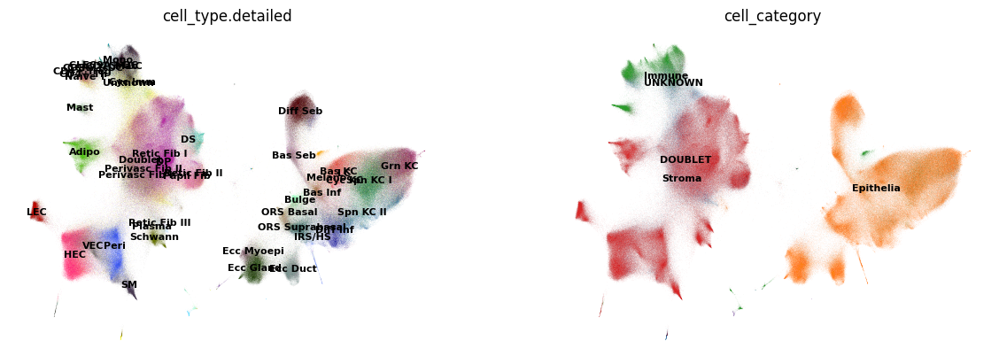

In [148]:
sc.pl.embedding(adata, basis='scvi_umap', color=['cell_type.detailed', 'cell_category'], 
                legend_loc='on data', legend_fontsize=8, alpha=0.5, frameon=False, show=True)

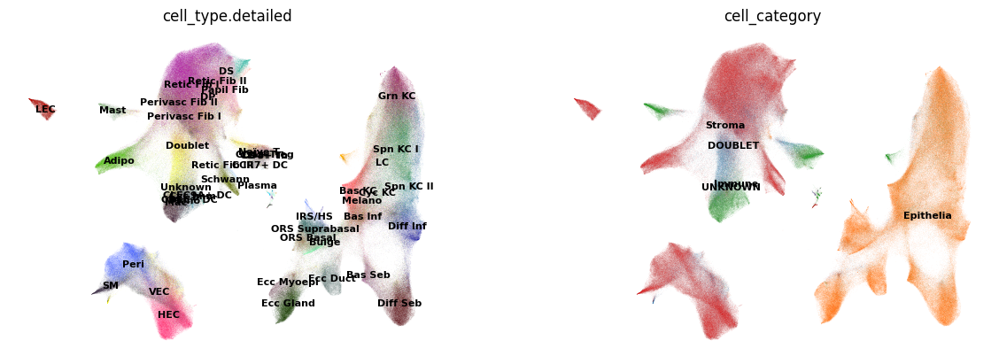

In [149]:
sc.pl.embedding(adata, basis='scanvi_umap', color=['cell_type.detailed', 'cell_category'], 
                legend_loc='on data', legend_fontsize=8, alpha=0.5, frameon=False, show=True)

In [161]:
toadd.to_csv("../../data/merfish/BAYSOR/seurat_objects/ns-atlas.merfish_baysor.intergated.reclustered.cell_metadata.annotated.csv", index=True)

In [150]:
neighborhoods = {
    0: "DEJ",
    1: "PERIVASC-I",
    2: "DIFF-IFE",
    3: "PERIVASC-II",
    4: "STROMA",
    5: "UPPER-HF",
    6: "ECCRINE",
    7: "SEB-GLND",
    8: "SUBCUTIS",
    9: "LOWER-HF"
}

In [151]:
adata.obs['neighborhood'] = adata.obs['cellcharter_cluster.k_10'].astype('category').map(neighborhoods)

In [152]:
adata.write_h5ad("../../data/merfish/BAYSOR/seurat_objects/ns-atlas.merfish_baysor.scanvi_integrated.cellcharter.anndata.annotated.h5ad", compression='gzip')

In [153]:
del barcodes
del celltype2category
del neighborhoods
gc.collect()

12535

In [3]:
adata = sc.read_h5ad("../../data/merfish/BAYSOR/seurat_objects/ns-atlas.merfish_baysor.scanvi_integrated.cellcharter.anndata.annotated.h5ad")

In [4]:
adata = adata.copy()

In [5]:
rotated_coords = pd.read_csv("../../data/merfish/BAYSOR/metadata/rotated_tissue_coordinates.csv", index_col=0)

C:\Users\Paula\AppData\Local\Temp\ipykernel_30668\2515409672.py:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  rotated_coords = pd.read_csv("../../data/merfish/BAYSOR/metadata/rotated_tissue_coordinates.csv", index_col=0)


In [6]:
rotated_coords.index = rotated_coords.index.astype('str').values.tolist()

In [7]:
adata.obsm['spatial_rotated'] = np.array(rotated_coords).copy()

In [8]:
adata.obs['site_short'] = adata.obs['anatomic_site'].astype('str').values.tolist().copy()
adata.obs.loc[adata.obs['site_short'] == 'popliteal fossae', 'site_short'] = 'popliteal fossa'
adata.obs['site_short'] = adata.obs['site_short'].map(str.title)
adata.obs['site_short'] = adata.obs['site_short'].astype('category')

In [9]:
adata.obs['cell_type.detailed'] = adata.obs['cell_type.detailed'].astype('str').values.tolist()
adata.obs.loc[adata.obs['cell_type.detailed'] == 'Retic Fib III', 'cell_type.detailed'] = "Perineural Fib"
adata.obs['cell_type.detailed'] = adata.obs['cell_type.detailed'].astype('category')

In [10]:
import gc

In [11]:
gc.collect()

31

In [12]:
adata.write_h5ad("../../data/merfish/BAYSOR/seurat_objects/ns-atlas.merfish_baysor.scanvi_integrated.cellcharter.anndata.annotated.h5ad", compression='gzip')

In [13]:
gc.collect()

0

In [14]:
adata = adata[~adata.obs['cell_type.detailed'].isin(['Unknown', 'Doublet']), :].copy()

In [15]:
gc.collect()

3604

In [16]:
adata.write_h5ad("../../data/merfish/BAYSOR/seurat_objects/ns-atlas.merfish_baysor.scanvi_integrated.cellcharter.anndata.annotated.filtered.h5ad", compression='gzip')

In [17]:
adata.obs.to_csv("../../data/merfish/BAYSOR/seurat_objects/ns-atlas.merfish_baysor.scanvi_integrated.cellcharter.anndata.annotated.filtered.csv", index=True)

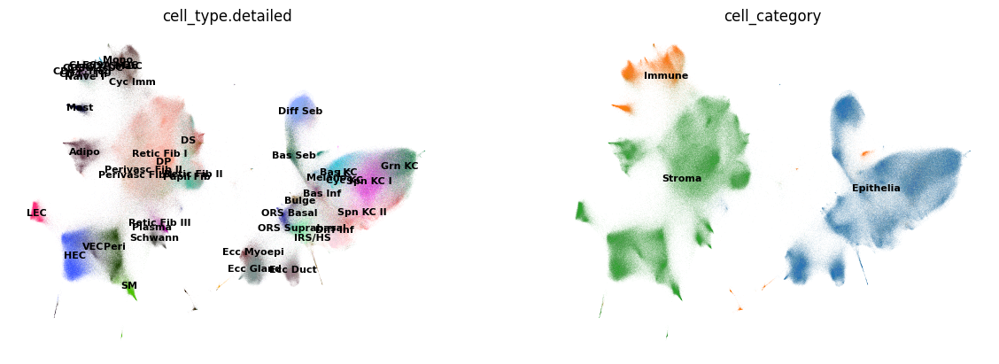

In [13]:
sc.pl.embedding(adata, basis='scvi_umap', color=['cell_type.detailed', 'cell_category'], 
                legend_loc='on data', legend_fontsize=8, alpha=0.5, frameon=False, show=True)

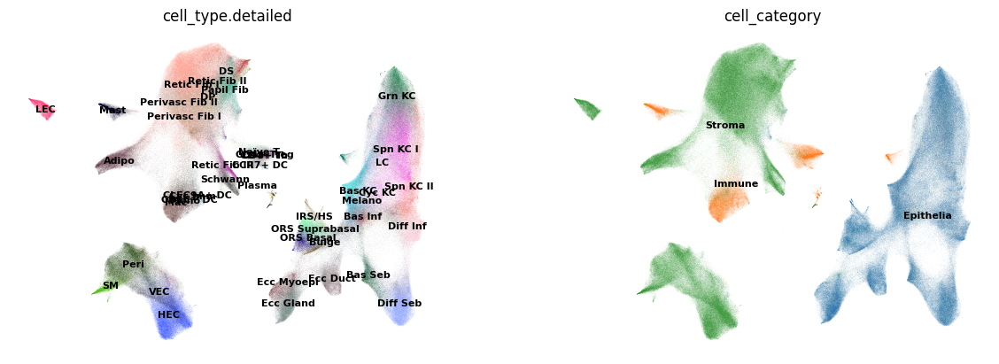

In [10]:
sc.pl.embedding(adata, basis='scanvi_umap', color=['cell_type.detailed', 'cell_category'], 
                legend_loc='on data', legend_fontsize=8, alpha=0.5, frameon=False, show=True)

# Spatial Plots of Whole Dataset

## Cell Type Detailed

In [18]:
detailed_celltype_colors = pd.read_csv("../../data/reference/cell_type.detailed.color_palette.varibow.non_shuffled.csv", index_col=0)
detailed_celltype_colors = detailed_celltype_colors['varibow.detailed'].to_dict()

In [38]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_spatial_by_sample(
    adata,
    annot_key,
    sample_key="sample_barcode",
    basis='spatial_rotated',
    palette=None,
    ncols=9,
    figsize=(5, 5),
    scale_bar_length_um=1000,  # 1 mm = 1000 µm
    scale_bar_color="black",
    scale_bar_linewidth=3,
    scale_bar_label="1 mm"
):
    samples = adata.obs[sample_key].cat.categories.unique().sort_values()
    n_samples = len(samples)

    ncols = min(n_samples, ncols)
    nrows = (n_samples + ncols - 1) // ncols

    fig, axes = plt.subplots(nrows, ncols, figsize=(figsize[0]*ncols, figsize[1]*nrows))
    axes = np.array(axes).reshape(-1)

    for i, sample in enumerate(samples):
        ax = axes[i]
        adata_sub = adata[adata.obs[sample_key] == sample]

        sc.pl.embedding(adata_sub,
                        basis=basis, 
                        title=f"{sample}",
                        color=annot_key,
                        palette=palette,  
                        ax=ax,
                        legend_loc='none', 
                        show=False)
        
        ax.set_aspect('equal', adjustable='datalim')
        ax.set_xticks([])
        ax.set_yticks([])
        ax.axis("off")


        # Get axis limits for placing scale bar
        x_min, x_max = ax.get_xlim()
        y_min, y_max = ax.get_ylim()

        # Scale bar position (bottom left corner with padding)
        x_start = x_min + 0.05 * (x_max - x_min)
        x_end = x_start + scale_bar_length_um
        y_pos = y_min + 0.05 * (y_max - y_min)

        # Add scale bar
        ax.plot([x_start, x_end], [y_pos, y_pos], color=scale_bar_color, lw=scale_bar_linewidth)
        ax.text((x_start + x_end) / 2, y_pos - 0.03 * (y_max - y_min),
                scale_bar_label, color=scale_bar_color, ha='center', va='top', fontsize=10)


    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)


    plt.tight_layout()
    plt.savefig(f"../../figures/merfish/BAYSOR/annotated/{annot_key}.detailed_celltype.spatial_plot.png", dpi=150)
    plt.savefig(f"../../figures/merfish/BAYSOR/annotated/{annot_key}.detailed_celltype.spatial_plot.pdf")
    plt.show()
    plt.close()

c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\plotting\_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\plotting\_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\plotting\_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\plotting\_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
c:\Users\Paula\miniconda3\envs\r

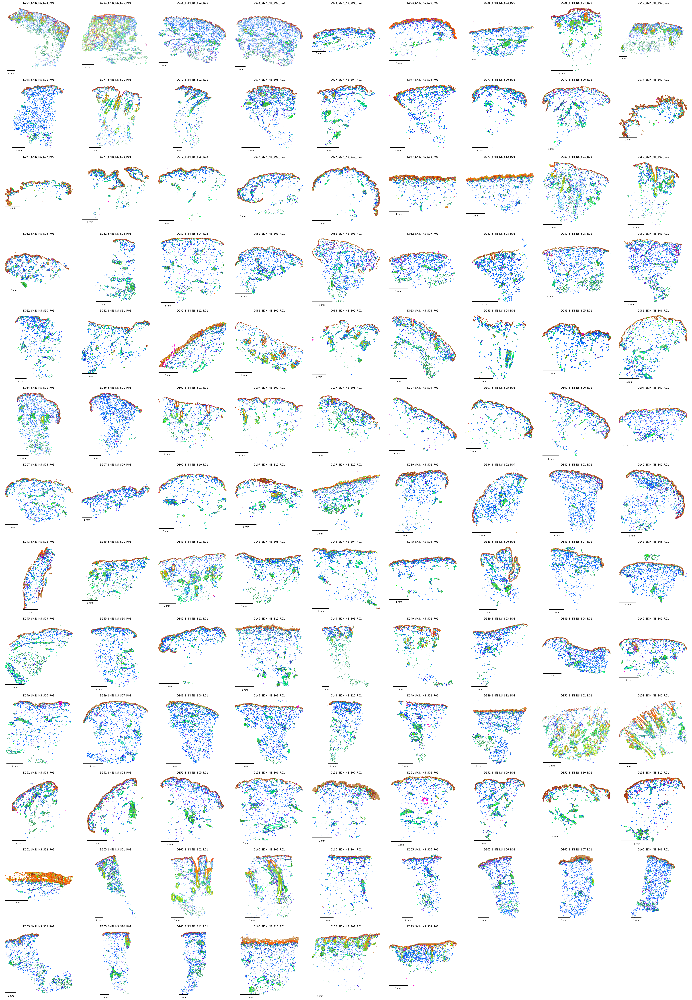

In [39]:
plot_spatial_by_sample(adata, annot_key='cell_type.detailed', palette=detailed_celltype_colors)

In [20]:
import matplotlib.patches as mpatches

In [21]:
def plot_spatial_per_sample_loop(
    adata,
    annot_key,
    sample_key="sample_barcode",
    basis='spatial_rotated',
    palette=None,
    scale_bar_length_um=1000,  # 1 mm = 1000 µm
    scale_bar_color="black",
    scale_bar_linewidth=3,
    scale_bar_label="1 mm"
):
    samples = adata.obs[sample_key].cat.categories.unique().sort_values()

    handles = [mpatches.Patch(color=palette[c], label=c, edgecolor="black", linewidth=0.3) for c in palette.keys()]
    legend_cols = 3

    for i, sample in enumerate(samples):
        adata_sub = adata[adata.obs[sample_key] == sample]
        donor = adata_sub.obs['donor_id'].unique()[0]
        site = adata_sub.obs['site_short'].unique()[0]

        with plt.rc_context({"figure.figsize": (5, 5), "font.size": 14, "figure.constrained_layout.use": True}):
            fig = sc.pl.embedding(adata_sub,
                            basis=basis, 
                            title=f"{donor}: {site}",
                            color=annot_key,
                            palette=palette,  
                            legend_loc='none', 
                            show=False,
                            return_fig=True)
            ax = fig.axes[0]
            fig.subplots_adjust(right=0.80)

            ax.set_aspect('equal', adjustable='datalim')
            ax.set_xticks([])
            ax.set_yticks([])
            ax.spines[:].set_visible(False)
            ax.axis("off")  # hides frame/ticks but keeps data


            # Get axis limits for placing scale bar
            x_min, x_max = ax.get_xlim()
            y_min, y_max = ax.get_ylim()

            # Scale bar position (bottom left corner with padding)
            x_start = x_min + 0.05 * (x_max - x_min)
            x_end = x_start + scale_bar_length_um
            y_pos = y_min + 0.05 * (y_max - y_min)

            # Add scale bar
            ax.plot([x_start, x_end], [y_pos, y_pos], color=scale_bar_color, lw=scale_bar_linewidth)
            ax.text((x_start + x_end) / 2, y_pos - 0.03 * (y_max - y_min),
                    scale_bar_label, color=scale_bar_color, ha='right', va='top', fontsize=10)
            
            # ---- right-side, multi-column legend (same handles for all samples)
            fig.legend(
                handles=handles,
                loc="center left",
                bbox_to_anchor=(0.995, 0.5),
                frameon=False,
                title="Cell Type",
                ncol=legend_cols,
                handlelength=0.9,
                handleheight=0.9,
                labelspacing=0.4,
                columnspacing=0.8,
                fontsize=10,
                title_fontsize=14,
            )

            # leave space on right for the legend
            plt.tight_layout(rect=[0, 0, 0.80, 1])
            plt.savefig(f"../../figures/merfish/BAYSOR/annotated/animation/detailed_celltype_spatial/{sample}.detailed_celltype.spatial_plot.png", dpi=300, bbox_inches='tight')
            plt.close()

In [22]:
plot_spatial_per_sample_loop(adata, annot_key='cell_type.detailed', palette=detailed_celltype_colors)

C:\Users\Paula\AppData\Local\Temp\ipykernel_30668\591181809.py:14: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  handles = [mpatches.Patch(color=palette[c], label=c, edgecolor="black", linewidth=0.3) for c in palette.keys()]
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\plotting\_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
C:\Users\Paula\AppData\Local\Temp\ipykernel_30668\591181809.py:32: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  fig.subplots_adjust(right=0.80)
C:\Users\Paula\AppData\Local\Temp\ipykernel_30668\591181809.py:72: UserWarning: The figure layout has changed to tight
  plt.tight_layout(rect=[0, 0, 0.80, 1])
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\plotting\_utils

In [23]:
import glob
import imageio.v2 as imageio # Use imageio.v2 for newer versions
from PIL import Image

In [24]:
gif_name = '../../figures/merfish/BAYSOR/annotated/animation/detailed_celltype_spatial_animation.gif'
frame_files = glob.glob('../../figures/merfish/BAYSOR/annotated/animation/detailed_celltype_spatial/*.detailed_celltype.spatial_plot.png')

# Read the first image to initialize the GIF
first_image = Image.open(frame_files[0])

# Append the rest of the images
appended_images = [Image.open(file) for file in frame_files[1:]]

# Save the animated GIF
first_image.save(
    gif_name,
    save_all=True,
    append_images=appended_images,
    duration=1000,  # Duration for each frame in milliseconds
    loop=0        # 0 means infinite loop
)

## Neighborhoods

In [27]:
donor_ids = ['D165', 'D145', 'D149', 'D151', 'D107','D082', "D077"]

In [28]:
sample_map = adata.obs[['donor_id', 'sample_barcode']].drop_duplicates().reset_index(drop=True)
sample_map = sample_map[[x in donor_ids for x in sample_map['donor_id']]]
sample_map['donor_id'] = sample_map['donor_id'].astype('str').astype('category')
sample_map = dict(zip(np.sort(np.unique(sample_map['donor_id'])), [x for x in sample_map.groupby('donor_id').apply(lambda x: np.sort(x['sample_barcode']).tolist())]))
sample_map

C:\Users\Paula\AppData\Local\Temp\ipykernel_30668\999551164.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sample_map = dict(zip(np.sort(np.unique(sample_map['donor_id'])), [x for x in sample_map.groupby('donor_id').apply(lambda x: np.sort(x['sample_barcode']).tolist())]))
C:\Users\Paula\AppData\Local\Temp\ipykernel_30668\999551164.py:4: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sample_map = dict(zip(np.sort(np.unique(sample_map['donor_id'])), [x for x in sample_map.groupby('donor_id').apply(lambda 

{'D077': ['D077_SKIN_NS_S01_R01',
  'D077_SKIN_NS_S02_R01',
  'D077_SKIN_NS_S03_R01',
  'D077_SKIN_NS_S04_R01',
  'D077_SKIN_NS_S05_R01',
  'D077_SKIN_NS_S06_R01',
  'D077_SKIN_NS_S06_R02',
  'D077_SKIN_NS_S07_R01',
  'D077_SKIN_NS_S07_R02',
  'D077_SKIN_NS_S08_R01',
  'D077_SKIN_NS_S08_R02',
  'D077_SKIN_NS_S09_R01',
  'D077_SKIN_NS_S10_R01',
  'D077_SKIN_NS_S11_R01',
  'D077_SKIN_NS_S12_R01'],
 'D082': ['D082_SKIN_NS_S01_R01',
  'D082_SKIN_NS_S02_R01',
  'D082_SKIN_NS_S03_R01',
  'D082_SKIN_NS_S04_R01',
  'D082_SKIN_NS_S04_R02',
  'D082_SKIN_NS_S05_R01',
  'D082_SKIN_NS_S06_R01',
  'D082_SKIN_NS_S07_R01',
  'D082_SKIN_NS_S08_R01',
  'D082_SKIN_NS_S08_R02',
  'D082_SKIN_NS_S09_R01',
  'D082_SKIN_NS_S10_R01',
  'D082_SKIN_NS_S11_R01',
  'D082_SKIN_NS_S12_R01'],
 'D107': ['D107_SKIN_NS_S01_R01',
  'D107_SKIN_NS_S02_R01',
  'D107_SKIN_NS_S03_R01',
  'D107_SKIN_NS_S04_R01',
  'D107_SKIN_NS_S05_R01',
  'D107_SKIN_NS_S06_R01',
  'D107_SKIN_NS_S07_R01',
  'D107_SKIN_NS_S08_R01',
  'D107_SKIN

In [29]:
neighborhood_colors = {
    "DEJ": "#0000FF",
    "PERIVASC-I": "#FF0000",
    "DIFF-IFE": "#00FF00",
    "PERIVASC-II": "#000033",
    "STROMA": "#FF00B6",
    "UPPER-HF": "#005300",
    "ECCRINE": "#FFD300",
    "SEB-GLND": "#009FFF",
    "SUBCUTIS": "#9A4D42",
    "LOWER-HF": "#00FFBE"
}

c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\plotting\_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\plotting\_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\plotting\_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\plotting\_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
c:\Users\Paula\miniconda3\envs\r

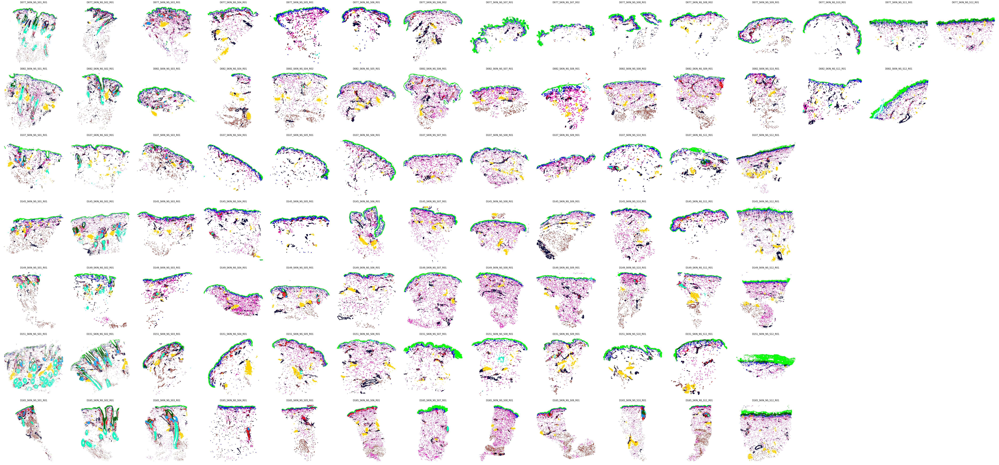

In [40]:
# Make Axes
# Number of needed rows and columns (based on the row with the most columns)
nrow = len(sample_map)
ncol = max([len(vs) for vs in sample_map.values()])
fig, axs = plt.subplots(nrow, ncol, figsize=(5 * ncol, 5 * nrow))
# Plot expression for every marker on the corresponding Axes object
for row_idx, (donor_id, sample_ids) in enumerate(sample_map.items()):
    col_idx = 0
    for sample_id in sample_ids:
        adata_sub = adata[adata.obs['sample_barcode']==sample_id]

        
        ax = axs[row_idx, col_idx]

        ax.set_aspect('equal', adjustable='datalim')
        ax.set_xticks([])
        ax.set_yticks([])

        sc.pl.embedding(adata_sub,
                        basis='spatial_rotated', 
                        title=f"{sample_id}", 
                        color='neighborhood',
                        palette=neighborhood_colors,  
                        ax=ax,
                        legend_loc='none', 
                        show=False)
        
        ax.axis("off")
        col_idx += 1
    # Remove unused column Axes in the current row
    while col_idx < ncol:
        axs[row_idx, col_idx].remove()
        col_idx += 1


plt.tight_layout()
plt.savefig(f"../../figures/merfish/BAYSOR/annotated/samplegrid.neighborhood.spatial_plot.png", dpi=150)
plt.savefig(f"../../figures/merfish/BAYSOR/annotated/samplegrid.neighborhood.spatial_plot.pdf")
plt.show()
plt.close()

In [35]:
def plot_spatial_per_sample_loop(
    adata,
    annot_key,
    sample_key="sample_barcode",
    basis='spatial_rotated',
    palette=None,
    scale_bar_length_um=1000,  # 1 mm = 1000 µm
    scale_bar_color="black",
    scale_bar_linewidth=3,
    scale_bar_label="1 mm"
):
    samples = adata.obs[sample_key].cat.categories.unique().sort_values()

    handles = [mpatches.Patch(color=palette[c], label=c, edgecolor="black", linewidth=0.3) for c in palette.keys()]
    legend_cols = 1

    for i, sample in enumerate(samples):
        adata_sub = adata[adata.obs[sample_key] == sample]
        donor = adata_sub.obs['donor_id'].unique()[0]
        site = adata_sub.obs['site_short'].unique()[0]

        with plt.rc_context({"figure.figsize": (5, 5), "font.size": 14, "figure.constrained_layout.use": True}):
            fig = sc.pl.embedding(adata_sub,
                            basis=basis, 
                            title=f"{donor}: {site}",
                            color=annot_key,
                            palette=palette,  
                            legend_loc='none', 
                            show=False,
                            return_fig=True)
            ax = fig.axes[0]
            fig.subplots_adjust(right=0.80)

            ax.set_aspect('equal', adjustable='datalim')
            ax.set_xticks([])
            ax.set_yticks([])
            ax.spines[:].set_visible(False)
            ax.axis("off")  # hides frame/ticks but keeps data


            # Get axis limits for placing scale bar
            x_min, x_max = ax.get_xlim()
            y_min, y_max = ax.get_ylim()

            # Scale bar position (bottom left corner with padding)
            x_start = x_min + 0.05 * (x_max - x_min)
            x_end = x_start + scale_bar_length_um
            y_pos = y_min + 0.05 * (y_max - y_min)

            # Add scale bar
            ax.plot([x_start, x_end], [y_pos, y_pos], color=scale_bar_color, lw=scale_bar_linewidth)
            ax.text((x_start + x_end) / 2, y_pos - 0.03 * (y_max - y_min),
                    scale_bar_label, color=scale_bar_color, ha='right', va='top', fontsize=10)
            
            # ---- right-side, multi-column legend (same handles for all samples)
            fig.legend(
                handles=handles,
                loc="center left",
                bbox_to_anchor=(0.995, 0.5),
                frameon=False,
                title="Neighborhood",
                ncol=legend_cols,
                handlelength=0.9,
                handleheight=0.9,
                labelspacing=0.4,
                columnspacing=0.8,
                fontsize=10,
                title_fontsize=14,
            )

            # leave space on right for the legend
            plt.tight_layout(rect=[0, 0, 0.80, 1])
            plt.savefig(f"../../figures/merfish/BAYSOR/annotated/animation/neighborhood_spatial/{sample}.neighborhood.spatial_plot.png", dpi=300, bbox_inches='tight')
            plt.close()

In [36]:
plot_spatial_per_sample_loop(adata, annot_key='neighborhood', palette=neighborhood_colors)

C:\Users\Paula\AppData\Local\Temp\ipykernel_30668\1734766718.py:14: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  handles = [mpatches.Patch(color=palette[c], label=c, edgecolor="black", linewidth=0.3) for c in palette.keys()]
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\plotting\_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
C:\Users\Paula\AppData\Local\Temp\ipykernel_30668\1734766718.py:32: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  fig.subplots_adjust(right=0.80)
C:\Users\Paula\AppData\Local\Temp\ipykernel_30668\1734766718.py:72: UserWarning: The figure layout has changed to tight
  plt.tight_layout(rect=[0, 0, 0.80, 1])
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\plotting\_ut

In [33]:
import glob
import imageio.v2 as imageio # Use imageio.v2 for newer versions
from PIL import Image

In [37]:
gif_name = '../../figures/merfish/BAYSOR/annotated/animation/neighborhood_spatial_animation.gif'
frame_files = glob.glob('../../figures/merfish/BAYSOR/annotated/animation/neighborhood_spatial/*.neighborhood.spatial_plot.png')

# Read the first image to initialize the GIF
first_image = Image.open(frame_files[0])

# Append the rest of the images
appended_images = [Image.open(file) for file in frame_files[1:]]

# Save the animated GIF
first_image.save(
    gif_name,
    save_all=True,
    append_images=appended_images,
    duration=1000,  # Duration for each frame in milliseconds
    loop=0        # 0 means infinite loop
)

# Split object by category for Visuualization

In [19]:
epithelia = adata[adata.obs['cell_category'] == 'Epithelia', :].copy()
immune = adata[adata.obs['cell_category'] == 'Immune', :].copy()
stroma = adata[adata.obs['cell_category'] == 'Stroma', :].copy()

In [15]:
del adata

In [20]:
gc.collect()

521

In [21]:
epithelia.write_h5ad("../../data/merfish/BAYSOR/reclustering/visualization/Epithelia.baysor_reclustered.final.h5ad", compression='gzip')


In [22]:
immune.write_h5ad("../../data/merfish/BAYSOR/reclustering/visualization/Immune.baysor_reclustered.final.h5ad", compression='gzip')

In [23]:
stroma.write_h5ad("../../data/merfish/BAYSOR/reclustering/visualization/Stroma.baysor_reclustered.final.h5ad", compression='gzip')

For vizualization purposes *only* split each compartment and do the scanvi integration/umap with the labels; we will then show this umap for the figures to summarise the annotations since the extensive subclustering previously done involves cleaning up missassignments across compartments.

In [ ]:
del epithelia
del immune
del stroma
gc.collect()